<a href="https://colab.research.google.com/github/Cipe96/EEG-Recognition/blob/main/Analisi_XAI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<font size=6>**EEG Recognition: Analisi XAI**</font>
</br><font size=3>*Marco Cipollina, Riccardo Era*</font>


<p style="font-size:4px;" align="justify">L'obiettivo di questo notebook è applicare tecniche di Explainable Artificial Intelligence (XAI) per analizzare il comportamento del modello convolutivo addestrato su dati EEG durante il progetto. In particolare, il focus sarà su:

*   Visualizzare l'impatto temporale nelle previsioni del modello;
*   Identificare quali canali EEG contribuiscono maggiormente alle previsioni del modello;
*   Visualizzare le posizioni dei canali EEG utilizzati, evidenziando quelli più significativi.</p>


<p style="font-size:4px;" align="justify">Capire l'importanza dei canali EEG non solo aiuta a migliorare l'interpretabilità del modello, ma può anche:


*   Ridurre la complessità computazionale escludendo i canali meno significativi;

*   Migliorare le applicazioni cliniche fornendo intuizioni utili per neurologi e ricercatori.


</p>

<font size=4>**Indice:**</font>
*   [Import librerie](#1)
*   [Caricamento dati e modello Separable](#2)
*   [Analisi XAI](#3)

<a name="1"></a>
# **Import librerie**

Importiamo le librerie e montiamo Google Drive per garantire l'accesso agli altri file.

In [ ]:
%%capture
!pip install mne

from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display, clear_output
from sklearn.utils import shuffle
import matplotlib.pyplot as plt
from google.colab import drive
import tensorflow as tf
import pandas as pd
import numpy as np
import mne
import sys
import os

SEED = 96                                                                       #Impostiamo un seme specifico per garantire la replicabilità degli esperimenti

In [ ]:
%%capture
drive.mount('/content/drive', force_remount=True)

# elimina la cartella sample_data creata automaticamente
! rm -r /content/sample_data

In [ ]:
#@title Percorso della cartella del progetto su Google Drive:

#@markdown Se la cartella del progetto si trova nella root di Drive, scrivere solo il suo nome:

PERCORSO_DRIVE = "EEG Recognition" #@param {type:"string"}

PERCORSO_DRIVE = '/content/drive/MyDrive/' + PERCORSO_DRIVE

In [ ]:
sys.path.append(PERCORSO_DRIVE)                                                 # ci permetterà di importare le funzioni presenti in altri file
from shared_utilities import convolutivo, channel_names                         # importare il classificatore convolutivo e la funzione per il nome dei canali

<a name="2"></a>
# **Caricamento dati e modello Separable**
Utilizziamo il modello Separable perché ha un collegamento diretto fra i 64 filtri ed i 64 canali.

Per fare un'analisi più approfondita è necessario caricare contemporaneamente più run del dataset originale. Carichiamo quindi tutti e tre i subset su cui abbiamo effettuato l'addestramento del convolutivo (01, 02 e 06 sulla banda ABG).

In [ ]:
#@title Carichiamo i dati
test_data_01 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R01/ABG/test_data_ABG.npy")
test_labels_01 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R01/ABG/test_labels_ABG.npy")
test_data_02 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R02/ABG/test_data_ABG.npy")
test_labels_02 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R02/ABG/test_labels_ABG.npy")
test_data_03 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R03/ABG/test_data_ABG.npy")
test_labels_03 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R03/ABG/test_labels_ABG.npy")
test_data_04 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R04/ABG/test_data_ABG.npy")
test_labels_04 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R04/ABG/test_labels_ABG.npy")
test_data_05 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R05/ABG/test_data_ABG.npy")
test_labels_05 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R05/ABG/test_labels_ABG.npy")
test_data_06 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R06/ABG/test_data_ABG.npy")
test_labels_06 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R06/ABG/test_labels_ABG.npy")

In [86]:
#@title Seleziona il modello sui quale effettuare la XAI, seleziona il percorso qui:
diz = {"Convolutivo": "best-ABG-finale_conv.keras", "Separable" : "best-ABG-finale.keras"}
modello = "Convolutivo" #@param ["Convolutivo", "Separable"]
nome_file = diz[modello]

In [87]:
#@title Carica i le tre versioni addestrate su R01, R02 e R06
model_path = f'{PERCORSO_DRIVE}/Dati preprocessati//'
file_path = 'Pesi convolutivo/' + nome_file
model_01 = tf.keras.models.load_model(model_path+ 'R01/' + file_path)
model_02 = tf.keras.models.load_model(model_path+ 'R02/' + file_path)
model_06 = tf.keras.models.load_model(model_path+ 'R06/' + file_path)

print("Stampa dell'architetture del modello caricato")
model_01.summary()

Stampa dell'architetture del modello caricato


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)           │ (None, 240, 64)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d (Conv1D)                      │ (None, 240, 64)             │          12,352 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 240, 64)             │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 240, 64)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling1d_2           │ (None, 64)                  │               0 │
│ (GlobalAveragePooling1D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 109)                 │           7,085 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 58,825 (229.79 KB)

 Trainable params: 19,565 (76.43 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 39,132 (152.86 KB)

<a name="3"></a>
# **Analisi XAI**

In [ ]:
#@title Funzioni utili

#Funzione per la saliency-map
def saliency_map(model, input_data, class_index):
    input_data = tf.convert_to_tensor(input_data, dtype=tf.float32)

    with tf.GradientTape() as tape:
        tape.watch(input_data)  # Tracciamo i gradienti rispetto all'input
        predictions = model(input_data)  # Predizione del modello
        loss = predictions[:, class_index]  # Label della classe target

    # Calcoliamo il gradiente rispetto all'input originale
    gradients = tape.gradient(loss, input_data)

    # Prendiamo il valore assoluto e rimuovi la dimensione batch
    saliency = tf.abs(gradients[0])

    # Normalizziamo la saliency map per una migliore visualizzazione
    saliency = saliency.numpy()
    saliency = (saliency - saliency.min()) / (saliency.max() - saliency.min() + 1e-8)

    return saliency


# Funzione per il montaggio dei canali
def get_evoked_montage(heatmap_data, media = True):

  # Carichiamo il montaggio BioSemi64
  montage = mne.channels.make_standard_montage('biosemi64')
  biosemi64_names = montage.ch_names

  # Prendiamo i canali comuni tra BioSemi64 e ch_names
  common_channels = [ch for ch in biosemi64_names if ch in ch_names]
  # prendiamo gli indici dei canali comuni in ch_names
  reorder_indices = [ch_names.index(ch) for ch in common_channels]

  # Troviamo i canali non in comune
  non_common_channels = [ch for ch in ch_names if ch not in common_channels]
  non_common_indices = [ch_names.index(ch) for ch in non_common_channels]

  final_channels = common_channels + non_common_channels
  final_indices = reorder_indices + non_common_indices

  heatmap_data = heatmap_data[final_indices, :]

  # Crea un'istanza MNE Evoked
  info = mne.create_info(ch_names=final_channels, sfreq=1, ch_types='eeg')

  if media:
    heatmap_data = heatmap_data.mean(axis=1)  # Media lungo l'asse temporale
    evoked = mne.EvokedArray(heatmap_data[:, np.newaxis], info, tmin=0)
  else:
    evoked = mne.EvokedArray(heatmap_data[:], info, tmin=0)

  # Aggiunta manuale delle coordinate per T9 e T10
  new_positions = {
      'T9': (-0.12, 0.0, 0.0),
      'T10': (0.12, 0.0, 0.0)
  }

  # Prendiamo le posizioni esistenti dei canali comuni
  existing_positions = {ch: montage.get_positions()['ch_pos'][ch] for ch in common_channels}

  # Combiniamo le posizioni esistenti con T9 e T10
  combined_positions = {**existing_positions, **new_positions}

  new_montage = mne.channels.make_dig_montage(combined_positions, coord_frame='head')

  return evoked.set_montage(new_montage)

---

In [88]:
#@title Personalizzazione grafici
#@markdown Seleziona la run sulla quale lavorare:
selezione_run = "R06" # @param ["R01","R02", "R03", "R04","R05", "R06" ]

#@markdown Seleziona il modello col quale lavorare:
selezione_modello = model_01 # @param ["model_01","model_02","model_06"] {"type":"raw"}

#@markdown Numero di grafici da visualizzare nei subplots:
grafici_subplots = 3 # @param {"type":"slider","min":1,"max":6,"step":1}

#@markdown Seleziona per vedere un singolo volontario o diversi:
selezione_modalita = "Singolo" # @param ["Multipla","Singolo"]

#@markdown Per la selezione in modalità "Singolo":
selezione_volontario = 0 # @param {"type":"slider","min":0,"max":108,"step":1}

target_layer_name= selezione_modello.layers[1].name

data = {"R01": test_data_01, "R02": test_data_02, "R03": test_data_03,
        "R04": test_data_04, "R05": test_data_05, "R06": test_data_06}
labels = {"R01": test_labels_01, "R02": test_labels_02, "R03": test_labels_03,
          "R04": test_labels_04, "R05": test_labels_05, "R06": test_labels_06}

ch_names = channel_names()

---

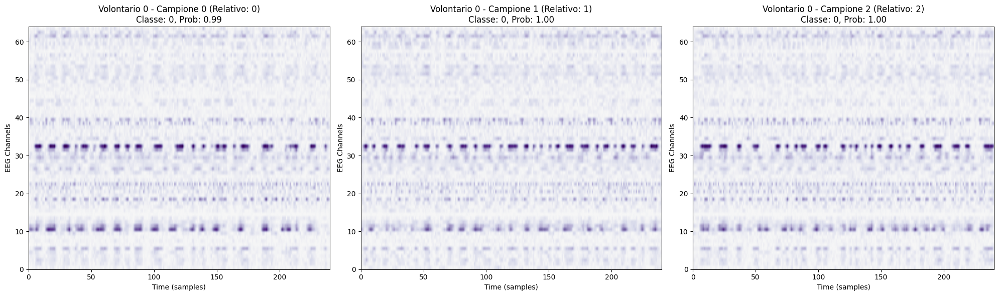

In [91]:
#@title Analisi Generale Saliency Map

# Array per tracciare i volontari già utilizzati
volontari_usati = []

num_colonne = 3
num_righe = (grafici_subplots + num_colonne - 1) // num_colonne
fig, axes = plt.subplots(num_righe, num_colonne, figsize=(20, num_righe * 6))
axes = axes.flatten()

# Contatore per plot già stati generati
num_plot = 0

if selezione_modalita == "Singolo":
    # Modalità Singolo: Trova i campioni della classe selezionata
    campioni_volontario = [
        i for i in range(len(labels[selezione_run])) if labels[selezione_run][i] == selezione_volontario
    ]
    selezione_campioni = campioni_volontario[:grafici_subplots]  # Primi N campioni
    campioni_relativi = list(range(len(selezione_campioni)))  # Indici relativi per campioni
else:  # Modalità Multipla
    selezione_campioni = []
    campioni_relativi = []
    volontari_usati = []

    while num_plot < grafici_subplots:
        indice_random = np.random.randint(0, len(labels[selezione_run]))
        label_volontario = labels[selezione_run][indice_random]

        if label_volontario in volontari_usati:
            continue  # Saltiamo se il volontario è già stato usato

        volontari_usati.append(label_volontario)
        selezione_campioni.append(indice_random)
        campioni_relativi.append(0)  # Indice relativo è 0 per il primo campione
        num_plot += 1

# Loop per i campioni selezionati
for idx, (campione_idx, campione_relativo) in enumerate(zip(selezione_campioni, campioni_relativi)):
    # Prepariamo l'input
    volontario_target = data[selezione_run][campione_idx]
    volontario_target_label = labels[selezione_run][campione_idx]
    volontario_target = np.expand_dims(volontario_target, axis=0)

    # Calcoliamo la Saliency Map
    saliency_output = saliency_map(selezione_modello, volontario_target, volontario_target_label)

    # Predizione del modello
    predizione = selezione_modello.predict(volontario_target)
    predizione_classe = np.argmax(predizione)
    predizione_prob = np.max(predizione)

    # Pposizione nella matrice di plot
    ax = axes[idx]

    # SaliencyMap per il campione corrente
    ax.imshow(saliency_output.T, aspect='auto', cmap='PuOr', vmin=-1, vmax=1, extent=[0, 240, 0, 64])
    ax.set_title(f"Volontario {volontario_target_label} - Campione {campione_idx} (Relativo: {campione_relativo})\n"
                 f"Classe: {predizione_classe}, Prob: {predizione_prob:.2f}")

    ax.set_xlabel("Time (samples)")
    ax.set_ylabel("EEG Channels")

clear_output(wait=True)
# Rimuovi subplot vuoti
for ax in axes[len(selezione_campioni):]:
    fig.delaxes(ax)

plt.tight_layout()
plt.show()

---

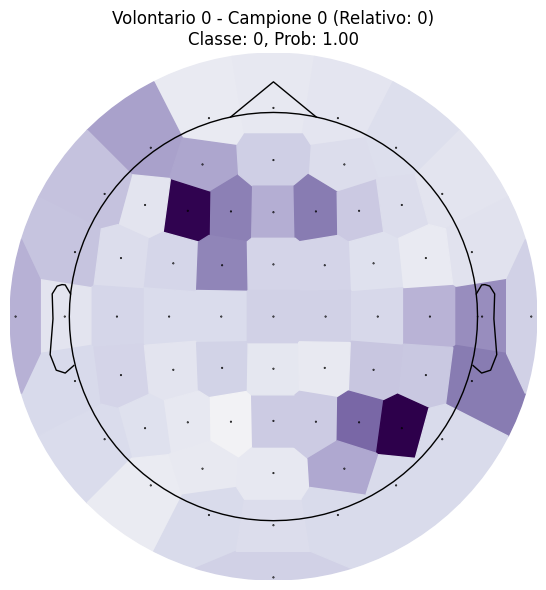

In [29]:
#@title Heatmap EEG del primo campione del volontario selezionato

# Riprendiamo lo stesso volontario
volontario_target = selezione_volontario

# Filtra i campioni dello stesso volontario e prendiamo il primo
campioni_volontario = [
    i for i in range(len(labels[selezione_run])) if labels[selezione_run][i] == volontario_target
]
indice_primo_campione = campioni_volontario[0]

# Prepariamo l'input
volontario_target_data = data[selezione_run][indice_primo_campione]
volontario_target_label = labels[selezione_run][indice_primo_campione]
volontario_target_data = np.expand_dims(volontario_target_data, axis=0)
#SaliencyMap
saliency_output = saliency_map(selezione_modello, volontario_target_data, volontario_target_label)

# Predizione del modello
predizione = selezione_modello.predict(volontario_target_data)
predizione_classe = np.argmax(predizione)
predizione_prob = np.max(predizione)

# Chiamiamo la funzione per il montaggio
evoked_montage = get_evoked_montage(saliency_output.T)

# Plot della mappa topografica
fig, ax = plt.subplots(figsize=(6, 6))
evoked_montage.plot_topomap(
    times=[0], size=3, axes=ax, ch_type='eeg', cmap="PuOr",
    image_interp="nearest", contours=0, colorbar=False, show=False
)
# Aggiungiamo le informazioni
ax.set_title(f"Volontario {volontario_target_label} - Campione {campione_idx} (Relativo: {campione_relativo})\n"
                 f"Classe: {predizione_classe}, Prob: {predizione_prob:.2f}")

clear_output(wait=True)
plt.tight_layout()
plt.show()


In [30]:
#@title Video completo della stessa heatmap EEG

# Monta l'oggetto evoked
evoked_montage = get_evoked_montage(saliency_output.T, media=False)
n_times = saliency_output.T.shape[1]  # Numero di campioni temporali
times = np.linspace(0, n_times - 1, n_times)

volontario_info = (f"Volontario {volontario_target_label} - Campione {campione_idx} (Relativo: {campione_relativo})\n"
                 f"Classe: {predizione_classe}, Prob: {predizione_prob:.2f}")

# Durata dell'animazione in secondi
duration = 24
frame_rate = len(evoked_montage.times) / duration  # Calcolo del frame rate

fig, ax = plt.subplots(figsize=(6, 6))

# Funzione per aggiornare i frame
def update_topomap(frame):
    ax.clear()
    evoked_montage.plot_topomap(
        times=[times[frame]], axes=ax, size=3, ch_type='eeg', cmap="PuOr",
        image_interp="nearest", contours=0, colorbar=False, show=False
    )
    ax.set_title(volontario_info, fontsize=12)

# Creiamo l'animazione
ani = FuncAnimation(fig, update_topomap, frames=n_times, interval=1000 / frame_rate)

HTML_output = HTML(ani.to_jshtml())
plt.close(fig)  # Evita di visualizzare un'immagine statica
display(HTML_output)


In [33]:
#@title Salvataggio dell'animazione
video_path = f"animazione_topomap_{selezione_run}_{selezione_volontario}.mp4"
ani.save(video_path, writer="ffmpeg", fps=10, extra_args=["-preset", "fast"])

---

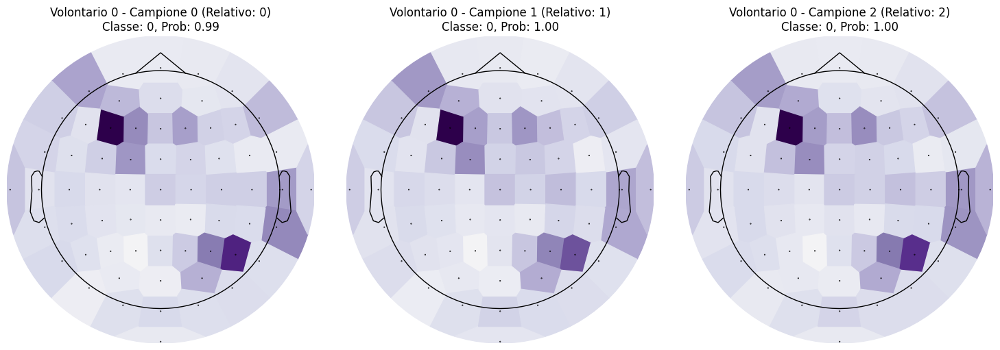

In [92]:
#@title Grafici Multi-Heatmaps
# Modalità Singolo
if selezione_modalita == "Singolo":
    campioni_volontario = [
        i for i in range(len(labels[selezione_run])) if labels[selezione_run][i] == selezione_volontario
    ]
    selezione_campioni = campioni_volontario[:grafici_subplots]
    campioni_relativi = list(range(len(selezione_campioni)))  # Indici relativi sequenziali
else:  # Modalità Multipla
    # Prendiamo i primi N volontari diversi
    volontari_unici = np.unique(labels[selezione_run])
    selezione_volontari = volontari_unici[:grafici_subplots]
    selezione_campioni = []
    campioni_relativi = []
    for volontario in selezione_volontari:
        campioni_per_classe = np.where(labels[selezione_run] == volontario)[0]
        selezione_campioni.append(campioni_per_classe[0])  # Prendi il primo campione
        campioni_relativi.append(0)  # Il primo campione relativo alla classe è 0


n_cols = 3
n_rows = (len(selezione_campioni) + n_cols - 1) // n_cols

# Griglia di subplot
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 5 * n_rows))
axes = axes.flatten()  # Rende la matrice degli assi 1D

for idx, (campione_idx, campione_relativo) in enumerate(zip(selezione_campioni, campioni_relativi)):

    volontario_target_data = data[selezione_run][campione_idx]
    volontario_target_label = labels[selezione_run][campione_idx]
    volontario_target_data = np.expand_dims(volontario_target_data, axis=0)

    # Saliency-map
    saliency_output = saliency_map(selezione_modello, volontario_target_data, volontario_target_label)

    predizione = selezione_modello.predict(volontario_target_data)
    predizione_classe = np.argmax(predizione)
    predizione_prob = np.max(predizione)

    evoked_montage = get_evoked_montage(saliency_output.T)

    # Asse corrente
    ax = axes[idx]

    evoked_montage.plot_topomap(
        times=[0], size=3, axes=ax, ch_type="eeg",
        cmap="PuOr", image_interp="nearest", contours=0, colorbar=False, show=False
    )

    ax.set_title(f"Volontario {volontario_target_label} - Campione {campione_idx} (Relativo: {campione_relativo})\n"
                 f"Classe: {predizione_classe}, Prob: {predizione_prob:.2f}")

for ax in axes[len(selezione_campioni):]:
    fig.delaxes(ax)
clear_output(wait=True)
plt.tight_layout()
plt.show()